# 📝 Overview
### Author: [Wannan (Winnie) Yang](https://winnieyangwannan.github.io/)

In this notebook, we will walk you through the complete process from loading the raw spiking data to generating beautiful visualization of them. You will see with your own eyes how the raw spiking data get transformed to the low-dimensional embedding!


You don't have to be familiar with Python to follow along. We have taken care of the set up steps so you only need to focus on playing with the data and visualize the result.


We will walk you through the process step by step. After going through this notebook, you will get from 'zero to hero' and get a concrete sense of how to do dimensionality reduction on neural data! 💪



⭐️ You can read more about the background and motivation of the project, visit our project website [here](https://winnieyangwannan.github.io/RippleTagging/projects/1_project/).


📑 You can access the paper [here](https://www.science.org/doi/10.1126/science.adk8261)
and [here](https://winnieyangwannan.github.io/RippleTagging/Paper/).


🔐 If you want to apply UMAP on your own data, you can follow [this Jupyter notebook](https://winnieyangwannan.github.io/RippleTagging/projects/5_project/) instead.

📭 Further feedbacks in general (including hot takes and criticisms) are welcome! (I love hot takes)! Feel free to [email me](mailto:winnieyangwn96@gmail.com)!

🔑  **Tips for reading this Colab:**
* You can run all this code for yourself!
* The graphs are interactive!
* Use the table of contents pane in the sidebar to navigate
* Collapse irrelevant sections with the dropdown arrows
* Search the page using the search in the sidebar, not CTRL+F

---

# 1️⃣ Preparation

To start with, we will install python packages and import them. The good thing about Google Colab is that you don't have to worry about setting up python enviornment locally on you computer. You only need to run the following cell in this section and everything will be installed and imported for you.

[link text](https://)
## Step 1: Set up python packages (don't read, just run)

- Install packages
- Import packages

In [ ]:
try:
    import google.colab # type: ignore
    IN_COLAB = True
except:
    IN_COLAB = False
import os, sys

if IN_COLAB:
    # Install packages
    %pip install umap-learn==0.5.3
    %pip install mat73
    %pip install plotly


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 kB 6.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.9/56.9 kB 2.8 MB/s eta 0:00:00
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82812 sha256=98f8896f8cac246bc7163982a60f22335f264f246afc94d3d7bfa51d2743b190
  Stored in directory: /root/.cache/pip/wheels/a0/e8/c6/a37ea663620bd5200ea1ba0907ab3c217042c1d035ef606acc
Successfully built umap-learn


In [ ]:
import os
import argparse
from time import time

import umap

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
from google.colab import files # for check file and download

import mat73
import pickle

import random
import numpy as np
import math
import pandas as pd
import csv
import statistics

from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import adjusted_rand_score, adjusted_mutual_info_score
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler


from scipy import stats as st
from scipy.ndimage import gaussian_filter
from scipy import stats
from scipy.interpolate import UnivariateSpline
from scipy.interpolate import NearestNDInterpolator
import scipy.io as sio
from scipy import interpolate


In [ ]:
# Check the version of UMAP (we use umap==0.5.3)
print(umap.__version__)

0.5.3


## Step 2: Download data

- Download the neural spiking data nd behavior data of one example session.
  - Here you can download our data easily by running the cell below.
- Change directory to the data folder.

In [ ]:
if IN_COLAB:

  ! git clone https://github.com/winnieyangwannan/Selection-of-experience-for-memory-by-hippocampal-sharp-wave-ripples.git

Cloning into 'Selection-of-experience-for-memory-by-hippocampal-sharp-wave-ripples'...
remote: Enumerating objects: 77, done.
remote: Counting objects: 100% (7/7), done.
remote: Compressing objects: 100% (7/7), done.
remote: Total 77 (delta 1), reused 0 (delta 0), pack-reused 70 (from 1)
Receiving objects: 100% (77/77), 255.34 MiB | 17.79 MiB/s, done.
Resolving deltas: 100% (20/20), done.
Updating files: 100% (18/18), done.


In [ ]:
if IN_COLAB:

  %ls
  %cd /content/Selection-of-experience-for-memory-by-hippocampal-sharp-wave-ripples
  %ls
  %cd Data
  %ls
  # (1) if the github link has been updated, copy the new link (even though it looks the same)
  # (2) if folder has exist error occur, run this:
  # (3) %rm -rf /content/Selection-of-experience-for-memory-by-hippocampal-sharp-wave-ripples
  # (4) restart the session after this step

sample_data/  Selection-of-experience-for-memory-by-hippocampal-sharp-wave-ripples/
/content/Selection-of-experience-for-memory-by-hippocampal-sharp-wave-ripples
Data/  LICENSE  main.py  README.md
/content/Selection-of-experience-for-memory-by-hippocampal-sharp-wave-ripples/Data
e13_26m1_210913.Behavior.mat
e13_26m1_210913.cell_type.mat
e13_26m1_210913.session.mat
e13_26m1_210913.spike_time.mat
e15_13f1_220118.data_behavior_shuffle_irc_all_trial_5_pos_5_speed_0_smooth_5_z_1_together_equal.mat
e15_13f1_220118.data_RSE_all_trial_5_pos_5_speed_0_smooth_3_z_1_together_equal.mat
e15_13f1_220118.position_behavior_shuffle_irc_all_trial_5_pos_5_speed_0_smooth_5_z_1_together_equal.mat
RO1_240106.Behavior.mat
RO1_240106.cell_type.mat
RO1_240106.session.mat
RO1_240106.spike_time.mat
RO1_240110.Behavior.mat
RO1_240110.cell_type.mat
RO1_240110.session.mat
RO1_240110.spike_time.mat


# 2️⃣ Step by step walkthrough with one example session


We can now start to play with the data.

First, we will define the parameters and load the data we downloaded (Step 1-2).

Next, before doing dimensionality reduction, we need to first preprocess our data (Step 3)!

  - You can read the code in this section to get a detailed view of the the data preprocessing process, but I will summarize the main steps briefly here:
    
    - Preprocess position data 🐁
      - Resample the position data to 10Hz so that it is consistent with neural spiking data.

    - Preprocess neural spiking data 🧠
      - The goal is to take raw spiking data (spiking timestamps of all the cells) and get them into 100ms bins. In the end you will get a data matrix of dimesnion (num_cell, num_timeBin) .
      - after binning, the major steps including:
        - Smoothing
        - Z-score the spiking data
        - Speed thresholding (optional)

    - Alligh the spiking data with the position data.


⭐️⭐️ Then you can run UMAP (Step 4)!! ⭐️⭐️




🎬 Finally, we will visualize the UMAP result (we will generate interactive plots so that you can rotate the manifold) !


---


## Step 1: Define parameters

In [ ]:
basename='e13_26m1_210913'
sessionID = 2

params = {}

params = {
    'speed_lim':0,
    'supervised':False,
    'spk_bin':0.1,
    'sm_window':3,
    'seed':0,
    'trial_bin':5,
    'pos_bin':5,
    'method':'umap',
    'n_component':6,
    'iterations':2000,
    'num_shuffle': 0,
    'sub_cell': 'all',
    'show_plot': True,
}



##  Step 2: Load data

Here, we load the data from one example session.

In this example session, we simultaneously recorded from 482 neurons in the CA1 region of the hippocampus!  


The mouse was trained to learn a spatial alternation task on the figure-8 maze where the animal learns to alternate between the left and right side of the arm to gain reward (located at the top left and right corner of the maze).


The figure below shows the behavior trajectory of the animal during one example session. The behavior trajecotry was colored by the linearized position of the animal.


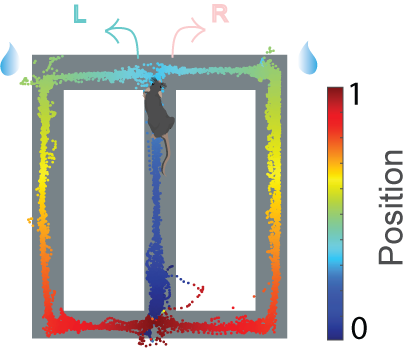

In [ ]:
def load_behavior_data(basename,sessionID):

    # LOAD SPIK TIME DATA
    spike_fname = basename + '.spike_time.mat'
    try:
        spike_mat = sio.loadmat(spike_fname)
    except:
        spike_mat = mat73.loadmat(spike_fname)

    spike_time = spike_mat['spike_time'][0]
    # LOAD BEHAVIOR DATA
    beh_fname = basename + '.Behavior.mat'
    try:
        beh_mat = sio.loadmat(beh_fname)
    except:
        beh_mat = mat73.loadmat(beh_fname)

    beh_time = beh_mat['behavior']['timestamps'][0][0]
    pos_x =beh_mat['behavior']['position'][0][0]['x'][0][0]
    pos_y = beh_mat['behavior']['position'][0][0]['y'][0][0]
    pos_lin = beh_mat['behavior']['position'][0][0]['lin'][0][0]
    trial_data = beh_mat['behavior']['masks'][0][0]['TRIALS'][0][0]

    # LOAD SESSION INFO
    session_fname = basename + '.session.mat'
    try:
        session_mat = sio.loadmat( session_fname)
    except:
        session_mat = mat73.loadmat( session_fname)

    try:
        session_epochs = session_mat['session']['epochs'][0][0]
        startTime = session_epochs[0,sessionID-1]['startTime'][0][0][0][0]
        stopTime = session_epochs[0,sessionID-1]['stopTime'][0][0][0][0]
    except:
        session_epochs = session_mat['session']['epochs']
        startTime = session_epochs[sessionID-1]['startTime']
        stopTime = session_epochs[sessionID-1]['stopTime']

    # LOAD CELL TYPE
    cell_fname = basename + '.cell_type.mat'
    try:
        cell_mat = sio.loadmat(cell_fname)
    except:
        cell_mat = mat73.loadmat(cell_fname)

    cell_type = cell_mat['cell_type'][0]
    # pyramidal_cell = []
    # for id,ct in enumerate(cell_type):
    #     if ct == 'Pyramidal Cell':
    #         pyramidal_cell.append(id)

    data = {}
    data= {'spike_time' : spike_time,
         'beh_time':beh_time,
         'pos_x':pos_x,
         'pos_y':pos_y,
         'pos_lin':pos_lin,
         'trial_data':trial_data,
         'session_epochs':session_epochs,
         'startTime':startTime,
         'stopTime':stopTime,
         'cell_type':cell_type,
    }

    del spike_fname,session_fname, beh_fname, cell_fname
    return data

In [ ]:
data = load_behavior_data(basename,sessionID)



## Step 3: Preprocess data

In [ ]:
def preprocess_behavior_data(data,params):

  spike_time = data['spike_time']
  beh_time = data['beh_time']
  pos_x = data['pos_x']
  pos_y = data['pos_y']
  pos_lin = data['pos_lin']
  trial_data = data['trial_data']
  session_epochs = data['session_epochs']
  startTime = data['startTime']
  stopTime = data['stopTime']
  cell_type = data['cell_type']

  speed_lim = params['speed_lim']
  spk_bin = params['spk_bin']
  sm_window = params['sm_window']
  seed = params['seed']
  trial_bin = params['trial_bin']
  pos_bin = params['pos_bin']
  num_shuffle = params['num_shuffle']
  sub_cell  = params['sub_cell']
  show_plot = params['show_plot']
  # 3.1 Get data to the behavior epoch

  beh_ts = (beh_time>startTime) &  (beh_time<stopTime)
  ts_beh =  beh_time[beh_ts]
  x_pos = pos_x[beh_ts]
  y_pos = pos_y[beh_ts]
  lin_pos = pos_lin[beh_ts]
  trial = trial_data[beh_ts]
  epoch_ind = sessionID*np.ones_like(x_pos)

  # 3.2.SPIKE COUNT
  num_cell = spike_time.shape[0]
  spk_ts = np.arange(ts_beh[0], ts_beh[-1], spk_bin)
  spk_count = np.zeros((num_cell,spk_ts.shape[0]-1))


  for spk in range(num_cell):
      # SPIKE COUNT
      hist_count = np.histogram(spike_time[spk],bins=spk_ts)
      spk_count[spk,:] = hist_count[0]

  spk_data = np.transpose(spk_count)
  spk_ts = spk_ts[1:]
  num_cell = spk_data.shape[1]

  # 3.3 interpolate the behavior data according to spike time
  interp_func = interpolate.interp1d(ts_beh, x_pos,kind ="cubic")
  x_pos_interp = interp_func(spk_ts)

  interp_func = interpolate.interp1d(ts_beh, y_pos,kind ="cubic")
  y_pos_interp = interp_func(spk_ts)

  interp_func = interpolate.interp1d(ts_beh, lin_pos,kind ="nearest")
  lin_pos_interp = interp_func(spk_ts)

  interp_func = interpolate.interp1d(ts_beh, trial, kind = "nearest")
  trial_interp = interp_func(spk_ts)

  interp_func = interpolate.interp1d(ts_beh, epoch_ind, kind = "nearest")
  epoch_interp = interp_func(spk_ts)

  # 3.4. smooth the behavior data
  x_pos_sm =gaussian_filter(x_pos_interp, sm_window)
  y_pos_sm =gaussian_filter(y_pos_interp, sm_window)
  lin_pos_sm =gaussian_filter(lin_pos_interp, sm_window)

  # # 3.5. plot the smoothed behavior data

  fig = go.Figure()
  fig.add_trace(go.Scatter(x= spk_ts[:] , y =lin_pos[:],mode='lines',name='Position'))
  fig.update_layout(
      title="Linearized Position",
      xaxis_title="Time (s)",
      yaxis_title="Trial no.",
      # legend_title="Legend Title",
      font=dict(
          family="sans-serif",
          size=20,
          color="black"
      )
  )
  if show_plot:
    fig.show()

  # 3.6. Get the trial data into trial blocks
  bins = np.arange(min(trial_interp),max(trial_interp)+5,5)
  trial_bin = np.histogram(trial_interp,bins=bins)
  trial_bins = trial_bin[1]
  num_trial_bin = trial_bins.shape[0]
  trial_count =  trial_bin[0]
  trial_num_ds_bin = trial_interp
  for tt,tb in enumerate(trial_bins):
    if tt<num_trial_bin-1:

        trial_num_ds_bin[(trial_interp>=trial_bins[tt]) & (trial_interp<(trial_bins[tt+1]))]=tt
    else:

        trial_num_ds_bin[trial_interp>=trial_bins[tt]]=tt

  trial_num_ds_bin = np.array(trial_num_ds_bin, dtype=int)


  fig = go.Figure()
  fig.add_trace(go.Scatter(x= spk_ts[:] , y =lin_pos_sm[:],mode='lines',name='Position'))
  fig.add_trace(go.Scatter(x= spk_ts[:] , y =trial_num_ds_bin[:],mode='lines',name='Trial'))
  fig.update_layout(
      title="Trial Block",
      xaxis_title="Time (s)",
      yaxis_title="Trial",
      font=dict(
          family="sans-serif",
          size=20,
          color="black"
      )
  )
  if show_plot:
    fig.show()
  # 3.7. Get the position data into pisition bins
  bins = np.arange(min(lin_pos_sm),max(lin_pos_sm)+5,5)
  pos_bin = np.histogram(lin_pos_sm,bins=bins)
  pos_bins = pos_bin[1]
  num_pos_bin = pos_bins.shape[0]
  pos_count =  pos_bin[0]
  pos_lin_ds_bin = lin_pos_interp
  for tt,tb in enumerate(pos_bins):
    if tt<num_pos_bin-1:

        pos_lin_ds_bin[(lin_pos_sm>=pos_bins[tt]) & (lin_pos_sm<(pos_bins[tt+1]))]=tt
    else:

        pos_lin_ds_bin[lin_pos_sm>=pos_bins[tt]]=tt
  pos_lin_ds_bin = np.array(pos_lin_ds_bin, dtype=int)
  fig = go.Figure()
  fig.add_trace(go.Scatter(x= spk_ts[:] , y =lin_pos_sm[:],mode='lines',name='Position'))
  fig.add_trace(go.Scatter(x= spk_ts[:] , y =pos_lin_ds_bin[:],mode='lines',name='Position bin'))
  fig.update_layout(
      title="Positin Bin",
      xaxis_title="Time (s)",
      yaxis_title="Position bins",
      font=dict(
          family="sans-serif",
          size=20,
          color="black"
      )
  )
  if show_plot:
    fig.show()


  # 3.8 Apply speed threshold
  speed_c = np.zeros_like(lin_pos_sm)

  for i in range(len(lin_pos_sm)-1):
      speed_c[i] = abs(lin_pos_sm[i+1]-lin_pos_sm[i])
  speed_c = speed_c/np.mean(np.diff(spk_ts))

  fig = go.Figure()
  fig.add_trace(go.Scatter(x=spk_ts,y=speed_c,name='Speed'))
  fig.add_trace(go.Scatter(x=spk_ts,y=lin_pos_sm,mode='lines',name='Position'))
  fig.add_trace(go.Scatter(x=spk_ts[speed_c>=speed_lim],y=lin_pos_sm[speed_c>=speed_lim],mode='markers',name='Position > speed_lim', marker=dict(
          size=2,
          )))
  if show_plot:
    fig.show()
  #
  speed_ts =  speed_c>=speed_lim
  pos_lin_bin = pos_lin_ds_bin[speed_ts]
  pos_x = x_pos_sm[speed_ts]
  pos_y = y_pos_sm[speed_ts]
  trial_num_bin = trial_num_ds_bin[speed_ts]
  epoch = epoch_interp[speed_ts]
  spk_data_speed = spk_data[speed_ts,:]



  # 3.9 Smooth and z score spike data
  spk_count_sm = np.zeros_like(spk_data_speed)
  spk_count_sm_z = np.zeros_like(spk_data_speed)

  spk_count_sm =gaussian_filter(spk_data_speed, sm_window,axes=0,mode='nearest',radius=sm_window)
  print(spk_count_sm.shape)
  spk_count_sm_z = stats.zscore(spk_count_sm,axis=0)
  print(spk_count_sm_z.shape)


  # plot spike data
  fig = px.imshow( np.transpose(spk_count_sm_z[0:500,:]))
  fig.update_layout(
      title="Spike Data",
      xaxis_title="Time (s)",
      yaxis_title="Cell",
      # legend_title="Legend Title",
      font=dict(
          family="sans-serif",
          size=20,
          color="black"
      )
  )
  if show_plot:
    fig.show()
  # 3.10 Add shuffle data (noise cloud)
  if num_shuffle>0 :
    shuffle_len= spk_count_sm_z.shape[0]*num_shuffle
    data_len = spk_count_sm_z.shape[0]
    data_embedding_all = spk_count_sm_z
    for i in range(num_shuffle):
      np.random.seed(i)
      embedding_shuffle = np.zeros_like(spk_count_sm_z)
      # shuffle row, for each collumn independently
      for c in range(spk_count_sm_z.shape[1]):
          shuffle_row = np.random.permutation(spk_count_sm_z.shape[0])
          embedding_shuffle[:,c] = spk_count_sm_z[shuffle_row,c]
      # shuffle column, for each row independently
      for r in range(spk_count_sm_z.shape[0]):
          shuffle_col = np.random.permutation(spk_count_sm_z.shape[1])
          embedding_shuffle[r,:] = embedding_shuffle[r,shuffle_col]
      # embedding_shuffle = np.random.permutation(spk_count_sm_z)
      data_embedding_all = np.concatenate((data_embedding_all,embedding_shuffle),axis =0)

  else:
    shuffle_len = 0
    data_len = spk_count_sm_z.shape[0]
    data_embedding_all = spk_count_sm_z

  # 3.11 Get specific cell type
  pyramidal = []
  interneuron = []

  for cc,cell in enumerate(cell_type):
    if cell == 'Pyramidal Cell':
      pyramidal.append(True)
      interneuron.append(False)

    else:
      pyramidal.append(False)
      interneuron.append(True)

  if sub_cell =='all':
    data_embedding = data_embedding_all
  elif sub_cell == 'pyramidal':
    data_embedding = data_embedding_all[:,pyramidal]
  elif sub_cell == 'interneuron':
    data_embedding = data_embedding_all[:,interneuron]

  # output data
  data_preprocess = {}
  data_preprocess = {'data_embedding':data_embedding,
                    'speed_ts':speed_ts,
                    'pos_lin_bin':pos_lin_bin,
                    'pos_x':pos_x,
                    'pos_y':pos_y,
                    'lin_pos_sm':lin_pos_sm,
                    'trial_num_bin':trial_num_bin,
                    'epoch':epoch,
                    'shuffle_len':shuffle_len,
                    'data_len':data_len,
                    'sub_cell':sub_cell,

                    }
  return data_preprocess

In [ ]:
data_preprocess = preprocess_behavior_data(data,params)


(21594, 482)
(21594, 482)


## Step 4: Do dimensionality reduciton with UMAP ⭐️

- After data preprocessing, you can now do dimensionality reduction with UMAP!

  - The input to the UMAP is the neural spiking matrix of shape (time bin, neuron).

  - The output of the UMAP is the lwo-dimensional embedding of the input data.
  
    - For example, if you choose to embed the data into a three-dimensional spaze, the shape of the output will be (time bin, 3).



  - 🧐 Want to know more about UMAP?
    - Please read our short inroduction of UMAP from our project website [here](https://winnieyangwannan.github.io/RippleTagging/projects/1_project/#part-2--dimensionality-reduction)!

In [ ]:
def run_dimensionality_reduction(data_preprocess,params):
  data_embedding = data_preprocess['data_embedding']
  speed_ts = data_preprocess['speed_ts']
  pos_lin_bin = data_preprocess['pos_lin_bin']
  pos_x = data_preprocess['pos_x']
  pos_y = data_preprocess['pos_y']
  lin_pos_sm = data_preprocess['lin_pos_sm']

  trial_num_bin = data_preprocess['trial_num_bin']
  epoch = data_preprocess['epoch']
  data_len = data_preprocess['data_len']
  shuffle_len = data_preprocess['shuffle_len']

  method = params['method']
  n_component = params['n_component']
  iterations = params['iterations']
  supervised = params['supervised']
  sub_cell  = params['sub_cell']

  decoding_target='trial'
  ########################### DECODING LABEL/TARGET #############################
  if decoding_target =='pos':

      target1 = np.ones((data_len,1))
      target2 = 10000*np.ones((shuffle_len,1))
      target = np.concatenate([target1, target2], axis=0)

      target_knn_1 =  np.expand_dims(pos_lin_bin,axis=1)
      target_knn_2 = 10000*np.ones((shuffle_len,1))
      target_knn = np.concatenate([target_knn_1,target_knn_2],axis=0)
      target_knn = np.ravel(target_knn)

  elif decoding_target =='trial':

      target1 = np.expand_dims(trial_num_bin,axis=1)
      target2 = 10000*np.ones((shuffle_len,1))
      target = np.concatenate([target1,target2],axis=0)
      print(target.shape)
      target_knn = target
      target_knn = np.ravel(target_knn)



  ##################  Perform dimensionality reduction ########################
  if n_component > np.shape(data_embedding)[1]:
      n_component = np.shape(data_embedding)[1]
  print('n_component')
  print(n_component)

  if method == 'pca':
      utrans = PCA(n_component=n_component)
  elif method =='umap':
      utrans = umap.umap_.UMAP(n_neighbors=20, n_components=n_component, metric='cosine', metric_kwds=None,
                              output_metric='euclidean',
                              output_metric_kwds=None, n_epochs=iterations, learning_rate=1.0, init='spectral',
                              min_dist=0.1, spread=1.0, low_memory=True,
                              n_jobs=-1, set_op_mix_ratio=1.0, local_connectivity=1.0, repulsion_strength=1.0,
                              negative_sample_rate=5, transform_queue_size=4.0,
                              a=None, b=None, random_state=None, angular_rp_forest=False, target_n_neighbors=-1,
                              target_metric='categorical', target_metric_kwds=None, target_weight=0.5,
                              transform_seed=42, transform_mode='embedding', force_approximation_algorithm=False,
                              verbose=False, tqdm_kwds=None, unique=False, densmap=False, dens_lambda=2.0,
                              dens_frac=0.3, dens_var_shift=0.1, output_dens=False, disconnection_distance=None,
                              precomputed_knn=(None, None, None))

  print('embedding ongoing...')

  print(f"original data shape: {data_embedding.shape}")
  print(f"target shape: {target.shape}")

  # DIMENSIONALITY REDUCTION WITH UMAP
  if supervised:
    embedding = utrans.fit_transform(data_embedding, y=target)
  else:
    embedding = utrans.fit_transform(data_embedding)


  print(f"low-dimensional data shape: {target.shape}")

  data_result = {}
  data_result = {'data_embedding':data_embedding,
                 'speed_ts':speed_ts,
                 'pos_lin_bin':pos_lin_bin,
                 'trial_num_bin':trial_num_bin,
                 'epoch':epoch,
                 'embedding':embedding,
                 'data_len':data_len,
                 'shuffle_len':shuffle_len,
                 'target':target,
                 'sub_cell':sub_cell,
                 'pos_x':pos_x,
                 'pos_y':pos_y,
                 'lin_pos_sm':lin_pos_sm,
                }
  return data_result

In [ ]:

data_result = run_dimensionality_reduction(data_preprocess,params)


(21594, 1)
n_component
6
embedding ongoing...
original data shape: (21594, 482)
target shape: (21594, 1)
low-dimensional data shape: (21594, 1)


## Step 5: Plot the results 🎨

We can color the neural manifold with either the linearized position of the animal or trial number.

⭐️⭐️⭐️ Notice ⭐️⭐️⭐️ The UMAP visualization we generated here is actually interactive!! You can rotate the manifold and inspect it from different angles. You can also zoom-in and out.  




In [ ]:
def plot_umap_result(data_result,dim1=0,dim2=1,dim3=2,with_shuffle=False):

    data_embedding = data_result['data_embedding']
    print("data_embedding")
    print(data_embedding.shape)
    embedding = data_result['embedding']
    pos_lin_bin = data_result['pos_lin_bin']
    lin_pos_sm = data_result['lin_pos_sm']
    pos_x = data_result['pos_x']
    pos_y = data_result['pos_y']
    trial_num_bin = data_result['trial_num_bin']
    data_len = data_result['data_len']
    shuffle_len = data_result['shuffle_len']
    target = data_result['target']

    # make interactive plot with plotly

    fig = make_subplots(rows=2, cols=2,
                        # specs=[[{'is_3d': True}, {'is_3d': False}]],
                        specs=[[{'type': 'scene'}, {'type': 'xy'}],
                                [{'type': 'scene'}, {'type': 'scene'}]], # scence make it 3d
                        subplot_titles=['Position manifold', 'Position trajectory',
                                        'Trial manifold', 'Trial trajectory'],
                        print_grid =False)
    # row 1 col 1 : Position manifold
    fig.add_trace(go.Scatter3d(x=embedding[:data_len,dim1], y=embedding[:data_len,dim2], z=embedding[:data_len,dim3],mode='markers',marker=dict(
            size=1,
            color=pos_lin_bin,                # set color to an array/list of desired values
            colorscale='jet',   # choose a colorscale
            opacity=0.8)), row=1, col=1)
    if with_shuffle:
        fig.add_trace(go.Scatter3d(x=embedding[data_len:,dim1], y=embedding[data_len:,dim2],z=embedding[data_len:,dim3],mode='markers',marker=dict(
                size=1,
                color='grey',                # set color to an array/list of desired values
                opacity=0.8)), row=1, col=1)
    # row 1 col 2: Position trajectory
    fig.add_trace(go.Scatter(x=pos_x, y=pos_y,mode='markers',marker=dict(
            size=1,
            color=pos_lin_bin,                # set color to an array/list of desired values
            colorscale='jet',   # choose a colorscale
            opacity=0.8)), row=1, col=2,
            )

    # row 2 col 1: Trial manifold
    fig.add_trace(go.Scatter3d(x=embedding[:data_len,dim1], y=embedding[:data_len,dim2], z=embedding[:data_len,dim3],mode='markers',marker=dict(
            size=1,
            color=trial_num_bin,                # set color to an array/list of desired values
            colorscale='jet',   # choose a colorscale
            opacity=0.8)), row=2, col=1)
    if with_shuffle:
        fig.add_trace(go.Scatter3d(x=embedding[data_len:,dim1], y=embedding[data_len:,dim2],z=embedding[data_len:,dim3],mode='markers',marker=dict(
                size=1,
                color='grey',                # set color to an array/list of desired values
                opacity=0.8)), row=2, col=1)
    # row 2 col 2: Trial trajectory
    fig.add_trace(go.Scatter3d(x=pos_x, y=pos_y,z = trial_num_bin,mode='markers',marker=dict(
            size=1,
            color=trial_num_bin,                # set color to an array/list of desired values
            colorscale='jet',   # choose a colorscale
            opacity=0.8,
            )), row=2, col=2)

    fig.update_xaxes(showgrid=False, zeroline=False,row=1, col=2)
    fig.update_xaxes(showgrid=False, zeroline=False,row=2, col=2)
    fig.update_yaxes(showgrid=False, zeroline=False,row=1, col=2)
    fig.update_yaxes(showgrid=False, zeroline=False,row=2, col=2)

    # no x axis y axis and no grid
    fig.update_scenes(xaxis_visible=False, yaxis_visible=False,zaxis_visible=False )
    fig.update_xaxes(visible=False)
    fig.update_yaxes(visible=False)


    # update figure size
    fig.update_layout(
        autosize=False,
        width=1000,
        height=1000,
        margin=dict(
            l=50,
            r=50,
            b=100,
            t=100,
            pad=4
        ))
    # update background color of all subplots as well as paper color
    fig.update_layout(
        plot_bgcolor='black',paper_bgcolor="black"

    )
    # update the font color
    fig.update_layout(font = dict(color = 'white'))

    fig.show()
    fig.write_html('umap_pos.html')
    return fig

In [ ]:
plot_umap_result(data_result)

data_embedding
(21594, 482)


In [ ]:
def plot_umap_result_matplotlib_and_save(data_result,dim1=0,dim2=1,dim3=2,with_shuffle=False):

    data_embedding = data_result['data_embedding']
    print("data_embedding")
    print(data_embedding.shape)
    embedding = data_result['embedding']
    pos_lin_bin = data_result['pos_lin_bin']
    lin_pos_sm = data_result['lin_pos_sm']
    pos_x = data_result['pos_x']
    pos_y = data_result['pos_y']
    trial_num_bin = data_result['trial_num_bin']
    data_len = data_result['data_len']
    shuffle_len = data_result['shuffle_len']
    target = data_result['target']

    cm = plt.cm.get_cmap('jet')


    # make interactive plot with plotly

    fig, axs = plt.subplots(1,2)


    # row 1 col 1 : Position manifold
    ax1 = fig.add_subplot(111,projection='3d')
    ax1.scatter(embedding[:data_len,dim1], embedding[:data_len,dim2], zs=embedding[:data_len,dim3],
                s=1, c=pos_lin_bin, cmap=cm)


    # axis not visible
    plt.axis('off')
    for ax in axs.ravel():
        ax.set_axis_off()
    # background color
    fig.patch.set_facecolor('black')
    ax1.patch.set_facecolor('black')

    # adjust the angle
    ax1.view_init(elev=20., azim=-35, roll=0) #adjust the angle


    fig.savefig("umap_demo.svg", format="pdf", bbox_inches="tight")
    files.download('umap_demo.svg')


    return fig

data_embedding
(21594, 482)


<ipython-input-18-7332a1c96924>:16: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

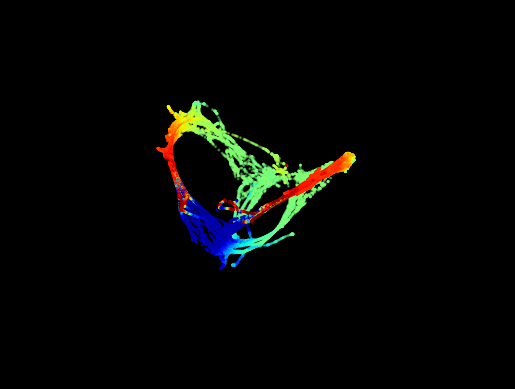

In [ ]:
fig = plot_umap_result_matplotlib_and_save(data_result)

### 👀 What are we looking at?

The top pannels are colored by the mouse's linearized position on the maze. The top left panel is the neural manifold colored by position (we call it position manifold), it is the low-dimensional embedding of the spiking data! The top right panel is animal running trajectory (tracked by a camera).


We can see a beautiful correspondence between the topology of the neural manifold and the topology of the maze! Hippocampus is indeed a cognitive map of the world! This is a very beautiful illustration but it is also what we expect -- given that we know there are place cells in the hippocampus, the population activity of the hippocampus is exptected to represent the gemotry of the place!

---

⭐️⭐️⭐️ What is truly amazing and certainly not expected is that when we color the neural manifold with trial number, we can see that each indivdual trial (event) can also be differentiated from each other. It is amazing that the representation of different trial are systematically organized in the exact same order as the events.


Heraclitus once said that “No man ever steps in the same river twice. For it’s not the same river and he’s not the same man.” Well, the brain is also not the same brain! Even though the animal went to the same location many times repeatedly, the neural activity was never the same again! It changes each time. Moreover, it changes in a very systematic way, organized in the same order as the unfolding of the events in time!



The bottom pannels are colored by the trial number. The bottom left panel is the neural manifold colored by trial number (we call it trial manifold)! The top right panel is animal running trajectory (tracked by a camera).

---

### 📍 Again, the plot above is interactive!
You can rotate the manifold and appreciate that there is trial-specific pattern is present throughout all different section of the maze!

---

#  3️⃣ Check out neural manifolds from different datasets

In our paper, we show that the trial specific population activity pattern (drift) can be also obeserved in different rodent species as they perform differnt tasks. Let's visualize them!

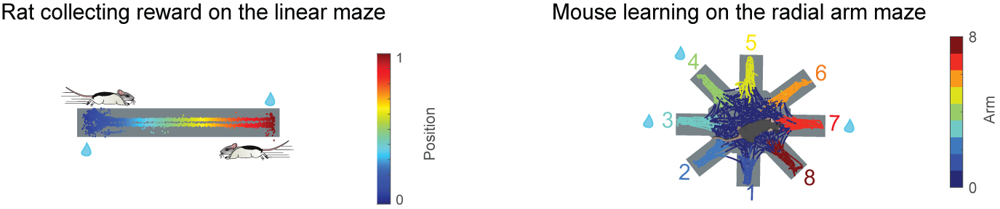

## 3.1 Linear maze


Here we show an exmple linear maze session where a mouse run back and forth to gain reward at the both ends of the maze.

You will notice that the population activity is again different across trials eventhough this is a very simple task!

In [ ]:
# 1. Define parameters
basename='RO1_240110'
sessionID = 2



params_linear = {
    'speed_lim':1,
    'supervised':False,
    'spk_bin':0.1,
    'sm_window':2,
    'seed':0,
    'trial_bin':5,
    'pos_bin':5,
    'method':'umap',
    'n_component':6,
    'iterations':2000,
    'num_shuffle':0,
    'sub_cell':'all',
    'show_plot':False,

}


# 2. load data
data = load_behavior_data(basename,sessionID)
# 3. preprocess data
data_preprocess_linear = preprocess_behavior_data(data,params_linear)
# 4. run dimesionality reduction
data_result_linear = run_dimensionality_reduction(data_preprocess_linear,params_linear)
# 5. plot
plot_umap_result(data_result_linear)

NameError: name 'load_behavior_data' is not defined

## 3.2 Radial arm maze

This is another example session, and here the animal wasperforming a task on the radial arm maze.

This is a much more complicated task with both working memory and reference memory component, yet we observe the same trial specific activity pattern!!



In [ ]:
# 1. Define parameters
basename='RO1_240106'
sessionID = 2



params_radial = {
    'speed_lim':1,
    'supervised':False,
    'spk_bin':0.1,
    'sm_window':2,
    'seed':0,
    'trial_bin':5,
    'pos_bin':5,
    'method':'umap',
    'n_component':6,
    'iterations':2000,
    'num_shuffle':0,
    'sub_cell':'all',
    'show_plot':False,

}


# 2. load data
data = load_behavior_data(basename,sessionID)
# 3. preprocess data
data_preproces_radial = preprocess_behavior_data(data,params_radial)
# 4. run dimesionality reduction
data_result_radial = run_dimensionality_reduction(data_preproces_radial,params_radial)
# 5. plot
plot_umap_result(data_result_radial)

(16352, 1)
n_component
6
embedding ongoing...
data_embedding shape: (16352, 253)
target shape: (16352, 1)
data_embedding
(16352, 253)


# How to cite us?

⭐️⭐️⭐️ If you had fun playing with the data and find this demo useful, you can cite us as:

[Wannan Yang](https://winnieyangwannan.github.io/), Chen Sun, Roman Huszár, Thomas Hainmueller, Kirill Kiselev, György Buzsáki. “Selection of experience for memory by hippocampal sharp wave ripple.” *Science* **383** 1478-1483 (2024).

You can access the paper at https://www.science.org/doi/10.1126/science.adk8261.

Visit our [project website](https://winnieyangwannan.github.io/RippleTagging/) to read more!



